In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Title: Optical Flow Dance Video using SIFT + Lucas-Kanade

We captured a selfie video involving hand/body motion and used the following method:

1. SIFT was used to detect strong features in the first frame.
2. These keypoints were tracked across frames using the Lucas-Kanade optical flow algorithm.
3. The flow vectors were visualized using color coding:
   - Hue: direction of motion
   - Value: magnitude (speed) of motion
4. Each frame’s optical flow was rendered on a black background.
5. All flow frames were saved and stitched into a final video.

Library Used: OpenCV (cv2)

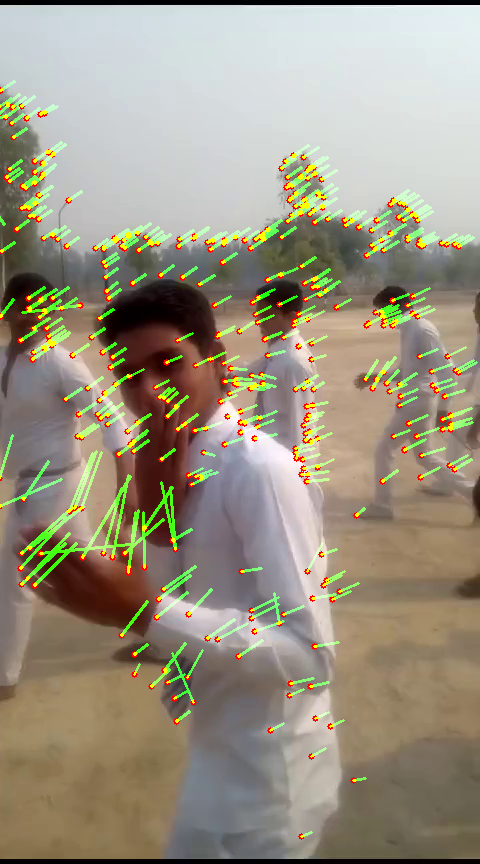

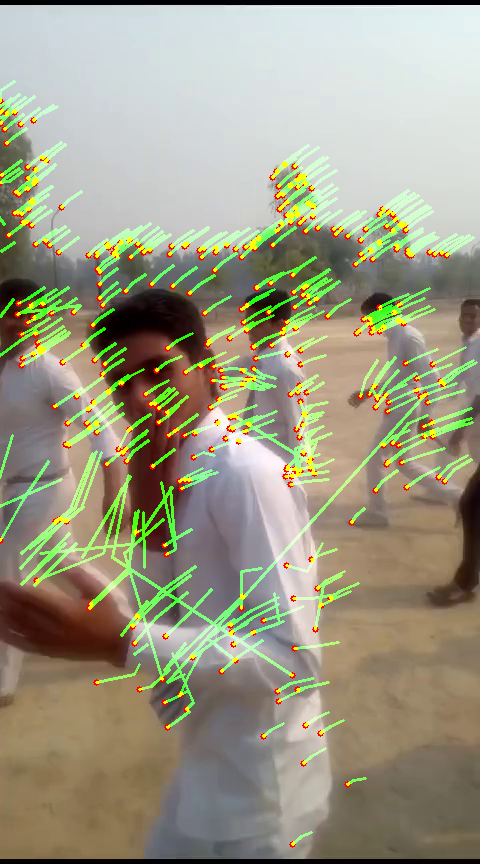

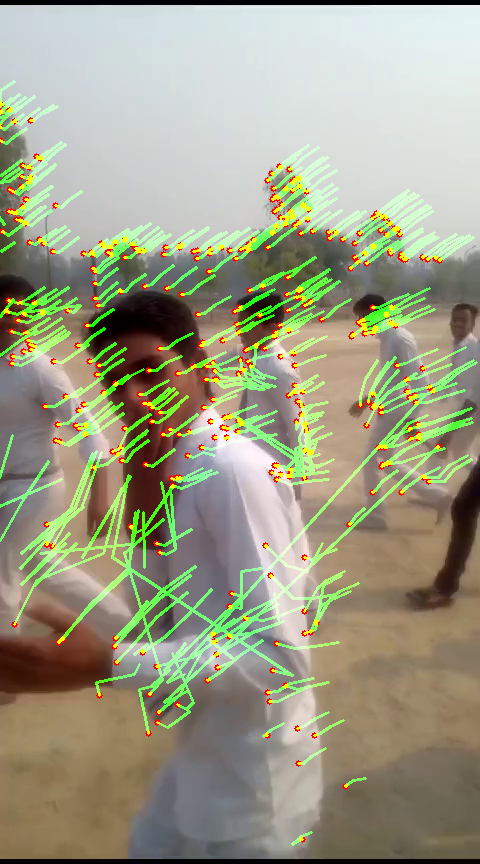

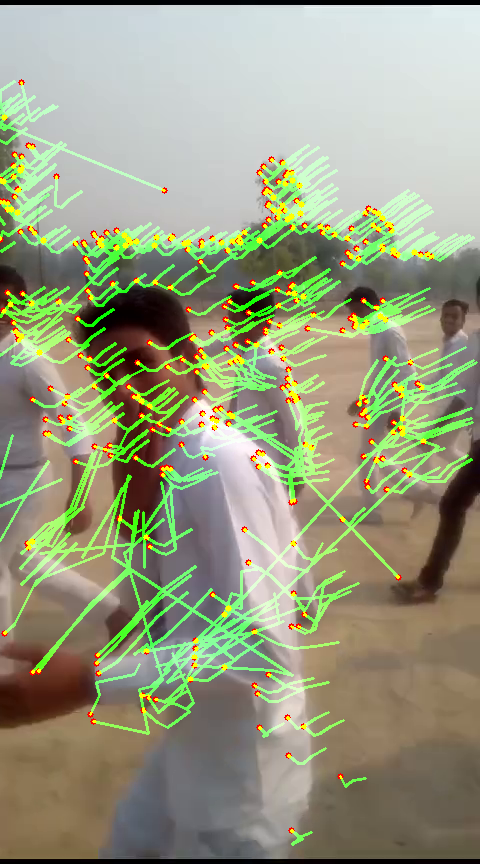

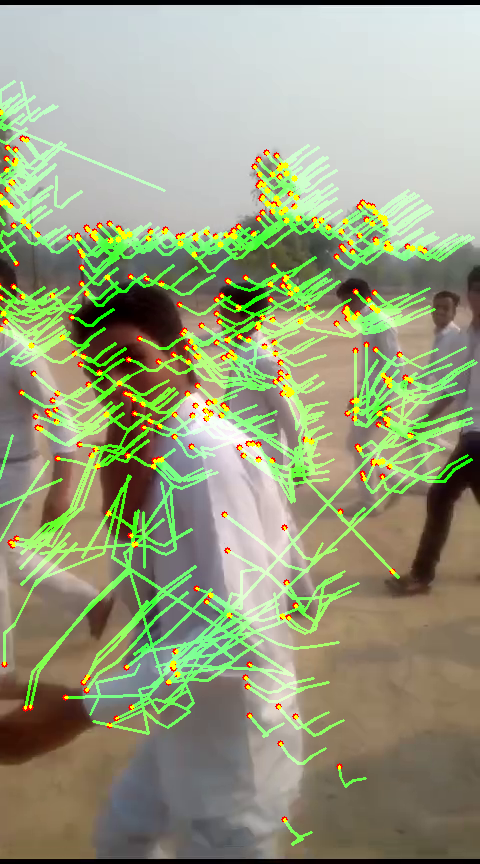

...

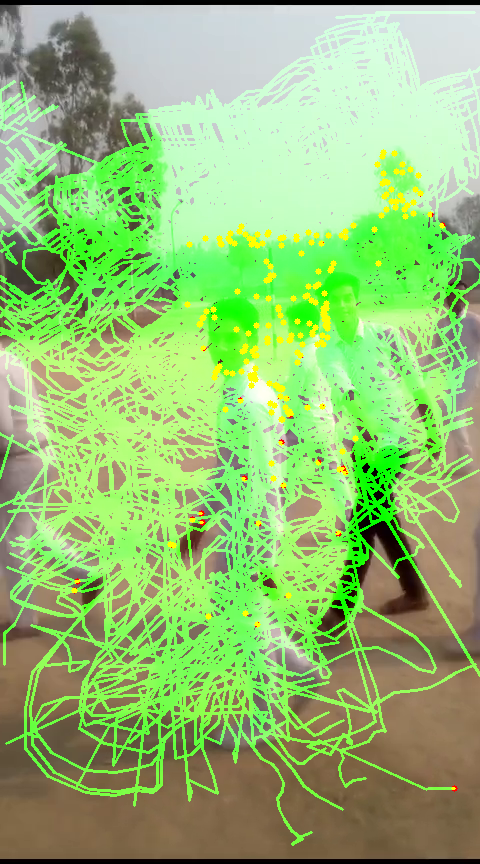

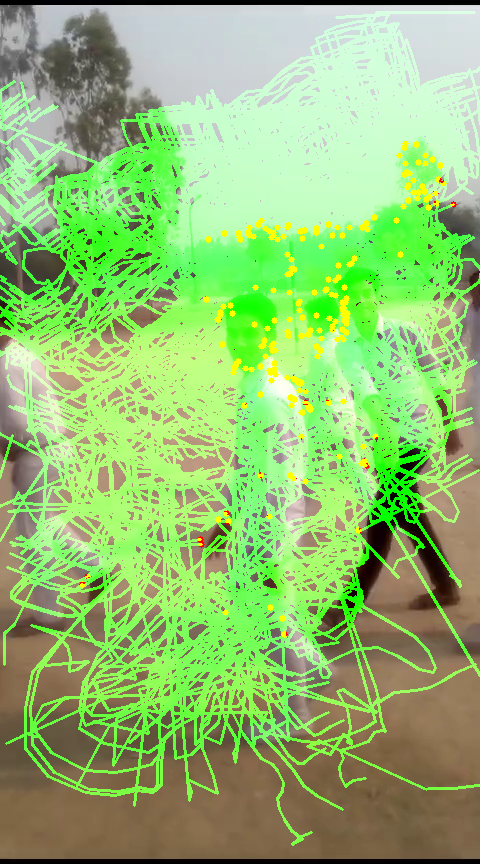

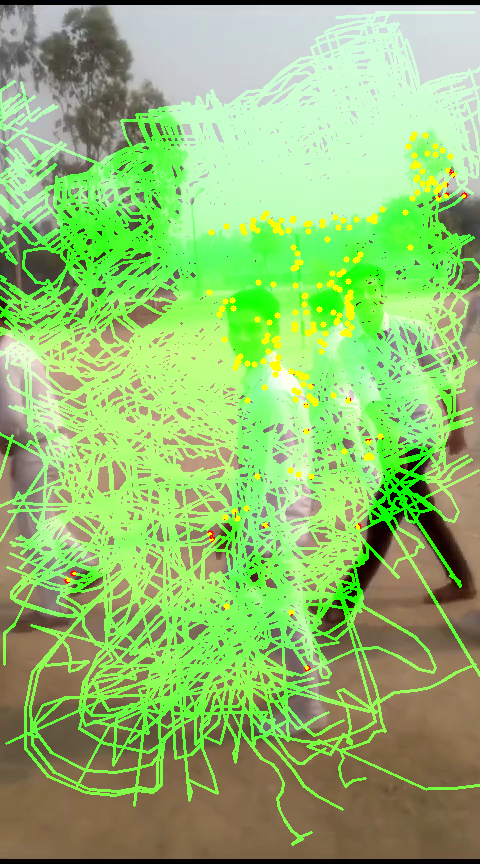

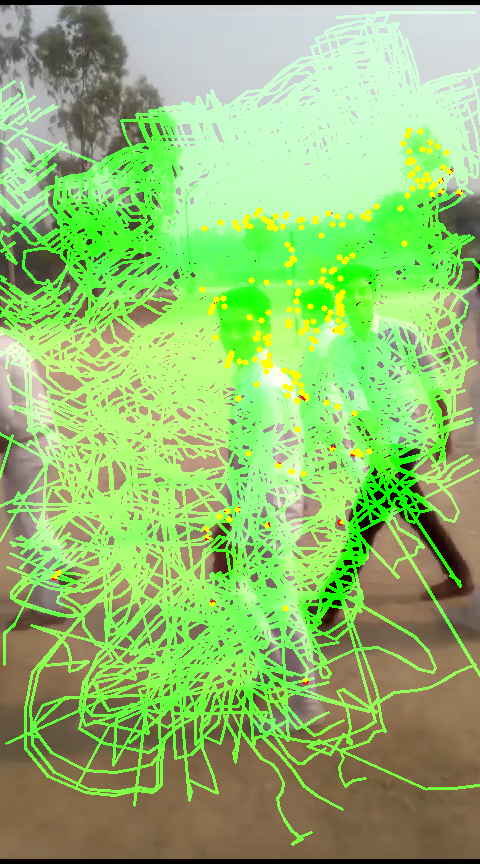

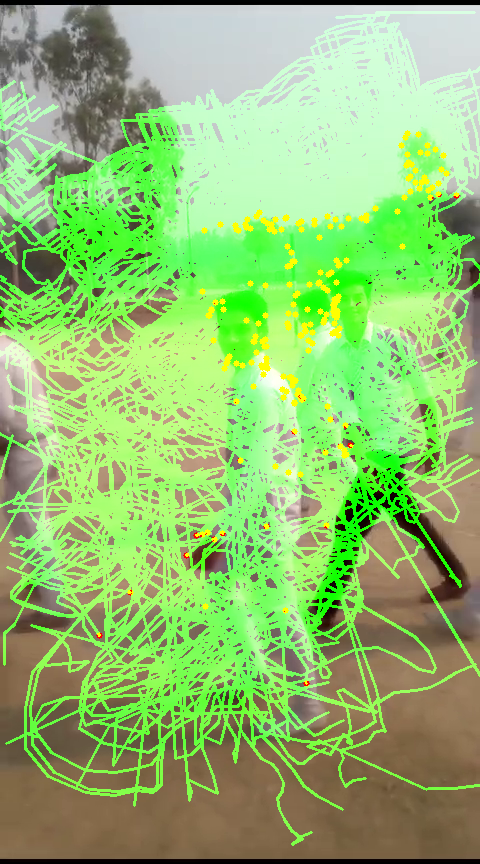

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import numpy as np

# Load video
cap = cv2.VideoCapture('/content/drive/MyDrive/InputVideo.mp4')

# Create SIFT detector
sift = cv2.SIFT_create()

# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize=(15, 15), maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

# Read first frame
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)

# Detect SIFT keypoints and convert to points
kp = sift.detect(old_gray, None)
old_points = np.array([k.pt for k in kp], dtype=np.float32).reshape(-1, 1, 2)

mask = np.zeros_like(old_frame)  # for drawing flow tracks

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # # Compute Optical Flow for SIFT keypoints
    # new_points, status, error = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, old_points, None, **lk_params)

    # # Select good points
    # good_new = new_points[status == 1]
    # good_old = old_points[status == 1]

    new_points, status, _ = cv2.calcOpticalFlowPyrLK(old_gray, frame_gray, old_points, None)

    # ✅ Check if tracking worked
    if new_points is None or status is None:
        print("⚠️ Optical flow tracking failed for this frame.")
        continue

    # ✅ Safe to use now
    good_new = new_points[status.flatten() == 1]
    good_old = old_points[status.flatten() == 1]


    # Draw the tracks
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.ravel()
        c, d = old.ravel()
        mask = cv2.line(mask, (int(a), int(b)), (int(c), int(d)), (0, 255, 0), 2)
        frame = cv2.circle(frame, (int(a), int(b)), 3, (0, 0, 255), -1)

    output = cv2.add(frame, mask)
    # cv2.imshow('SIFT Optical Flow', output)
    from google.colab.patches import cv2_imshow
    cv2_imshow(output)

    old_gray = frame_gray.copy()
    old_points = good_new.reshape(-1, 1, 2)


    if cv2.waitKey(30) & 0xFF == ord('q'):
        break
    new_points, status, _ = cv2.calcOpticalFlowPyrLK(old_gray, gray, old_points, None)

    # ✅ Check if tracking worked
    if new_points is None or status is None:
        print("⚠️ Optical flow tracking failed for this frame.")
        continue

# # ✅ Safe to use now
# good_new = new_points[status.flatten() == 1]
# good_old = old_points[status.flatten() == 1]


cap.release()
cv2.destroyAllWindows()



In [ ]:
import cv2
import numpy as np

cap = cv2.VideoCapture('/content/drive/MyDrive/InputVideo.mp4')
ret, prev_frame = cap.read()
prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

hsv = np.zeros_like(prev_frame)
hsv[..., 1] = 255

out = cv2.VideoWriter('optical_flow_dance.mp4',
                      cv2.VideoWriter_fourcc(*'mp4v'),
                      20, (prev_frame.shape[1], prev_frame.shape[0]))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    flow = cv2.calcOpticalFlowFarneback(prev_gray, gray, None,
                                        0.5, 3, 15, 3, 5, 1.2, 0)

    mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    hsv[..., 0] = ang * 180 / np.pi / 2
    hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)

    bgr_flow = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    # Black background
    black_bg = np.zeros_like(frame)
    black_bg[:] = bgr_flow

    out.write(black_bg)
    prev_gray = gray.copy()

cap.release()
out.release()
cv2.destroyAllWindows()